C:\Users\Vedant Shah\AppData\Local\Temp\ipykernel_22300\1329874818.py:20: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)


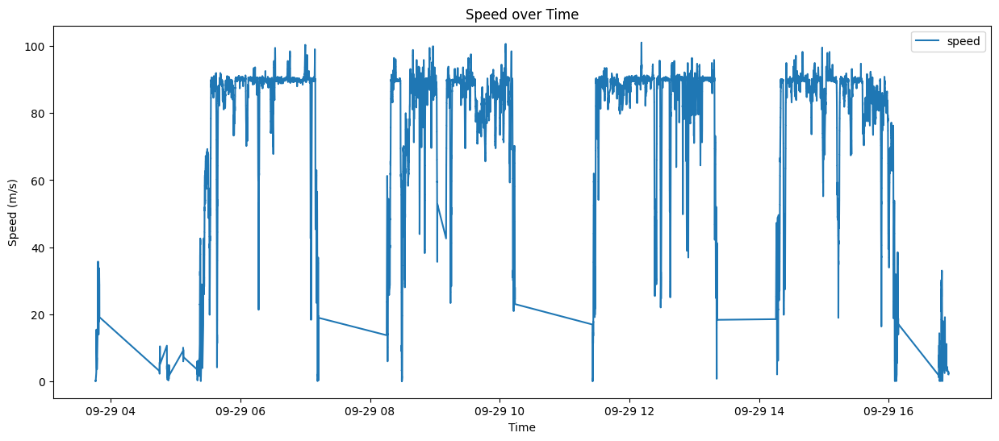

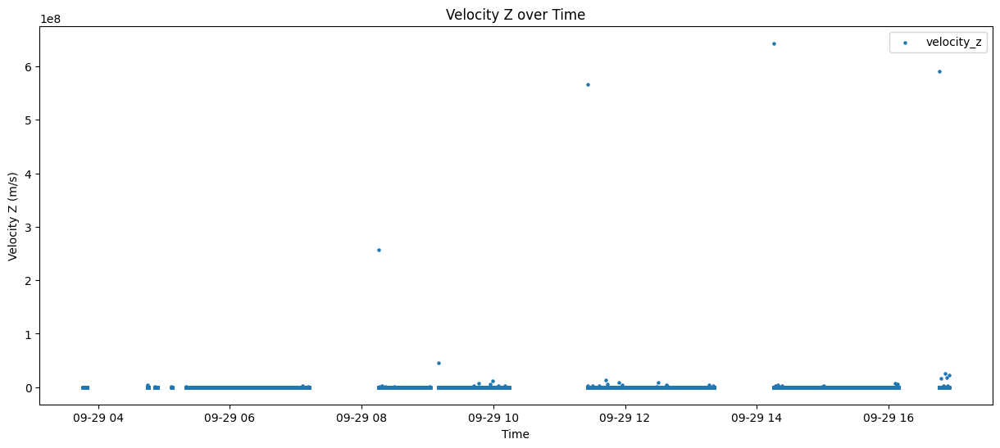

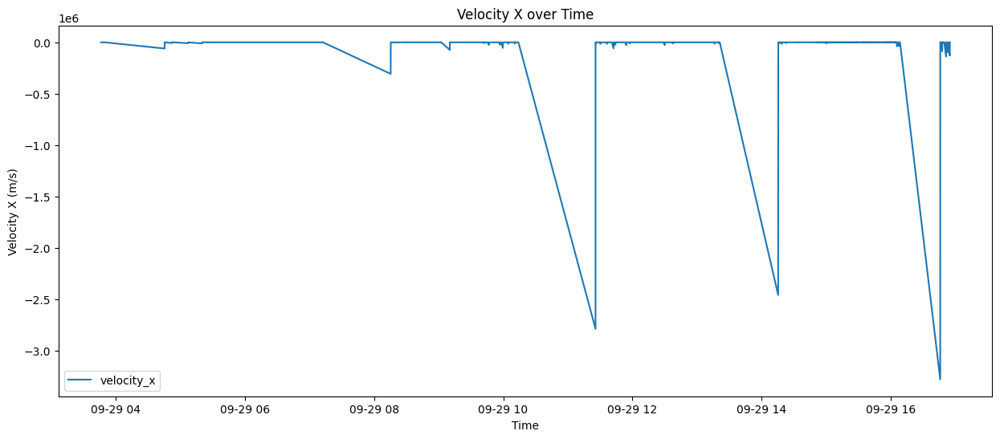

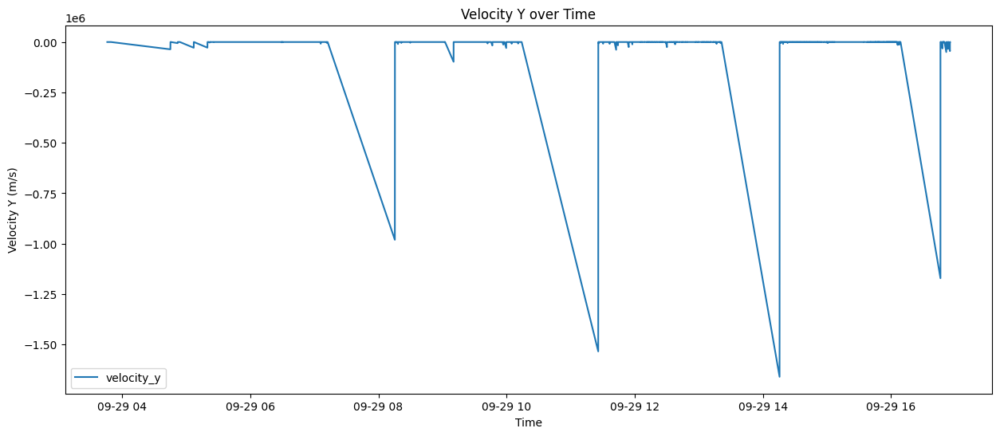

In [12]:
import pandas as pd
from sklearn.ensemble import IsolationForest
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from scipy.signal import find_peaks
from IPython.display import display
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.metrics import silhouette_score

# Load dataset
df = pd.read_csv('../Data/acceleration_data_in_bilbao_SP.csv')

# Preprocess data
df['time'] = pd.to_datetime(df['time'])
df = df.sort_values(by='time')
df.fillna(method='ffill', inplace=True)



df['velocity_z'] = np.cumsum(df['acc_z']) * (df['time'].diff().dt.total_seconds().fillna(0))
df['velocity_y'] = np.cumsum(df['acc_y']) * (df['time'].diff().dt.total_seconds().fillna(0))
df['velocity_x'] = np.cumsum(df['acc_x']) * (df['time'].diff().dt.total_seconds().fillna(0))

plt.figure(figsize=(15, 6))
plt.plot(df['time'], df['speed'], label="speed")
plt.title("Speed over Time")
plt.xlabel("Time")
plt.ylabel("Speed (m/s)")
plt.legend()
plt.show()




plt.figure(figsize=(15, 6))
plt.scatter(df['time'], df['velocity_z'], label="velocity_z", s=5)
plt.title("Velocity Z over Time")
plt.xlabel("Time")
plt.ylabel("Velocity Z (m/s)")
plt.legend()
plt.show()

plt.figure(figsize=(15, 6))
plt.plot(df['time'], df['velocity_x'], label="velocity_x")
plt.title("Velocity X over Time")
plt.xlabel("Time")
plt.ylabel("Velocity X (m/s)")
plt.legend()
plt.show()

plt.figure(figsize=(15, 6))
plt.plot(df['time'], df['velocity_y'], label="velocity_y")
plt.title("Velocity Y over Time")
plt.xlabel("Time")
plt.ylabel("Velocity Y (m/s)")
plt.legend()
plt.show()


In [3]:
#Descriptive Analysis

print(df.describe())

print(df.isnull().sum())

print(df.dtypes)


                                time          acc_x          acc_y  \
count                         262443  262443.000000  262443.000000   
mean   2022-09-29 10:47:35.667257856      -0.005591      -0.001974   
min       2022-09-29 03:46:06.458000      -0.519000      -0.295000   
25%    2022-09-29 07:09:28.214000128      -0.025000      -0.022000   
50%       2022-09-29 11:27:53.856000      -0.005000      -0.001000   
75%    2022-09-29 14:19:04.892000256       0.016000       0.019000   
max       2022-09-29 16:55:07.933000       0.267000       0.358000   
std                              NaN       0.037854       0.040085   

               acc_z          speed       latitude      longitude  \
count  262443.000000  262443.000000  262443.000000  262443.000000   
mean        1.012184      80.967359      42.805124      -3.529438   
min         0.144000       0.000000      42.356133      -4.242803   
25%         0.982000      82.000000      42.573081      -4.056762   
50%         1.011000    

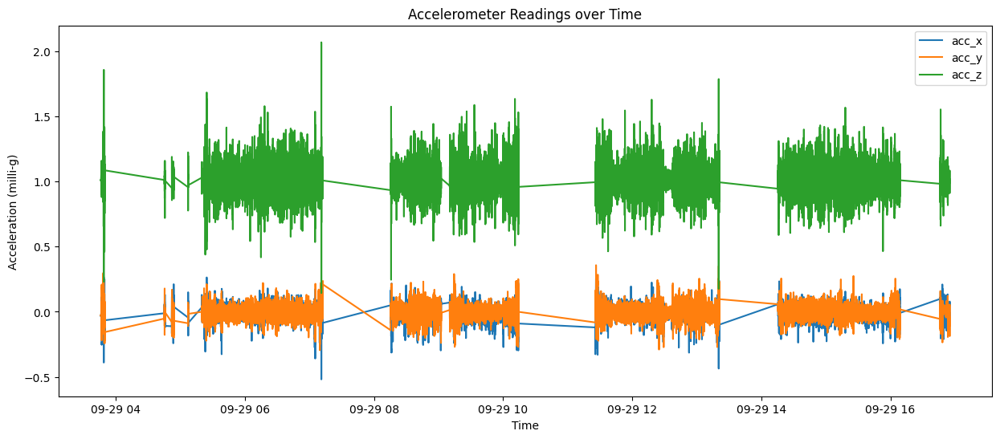

In [4]:
plt.figure(figsize=(15, 6))
plt.plot(df['time'], df['acc_x'], label="acc_x")
plt.plot(df['time'], df['acc_y'], label="acc_y")
plt.plot(df['time'], df['acc_z'], label="acc_z")
plt.title("Accelerometer Readings over Time")
plt.xlabel("Time")
plt.ylabel("Acceleration (milli-g)")
plt.legend()
plt.show()

df['magnitude'] = np.sqrt(df['acc_x']**2 + df['acc_y']**2 + df['acc_z']**2)
df['speed_diff'] = df['speed'].diff().fillna(0)


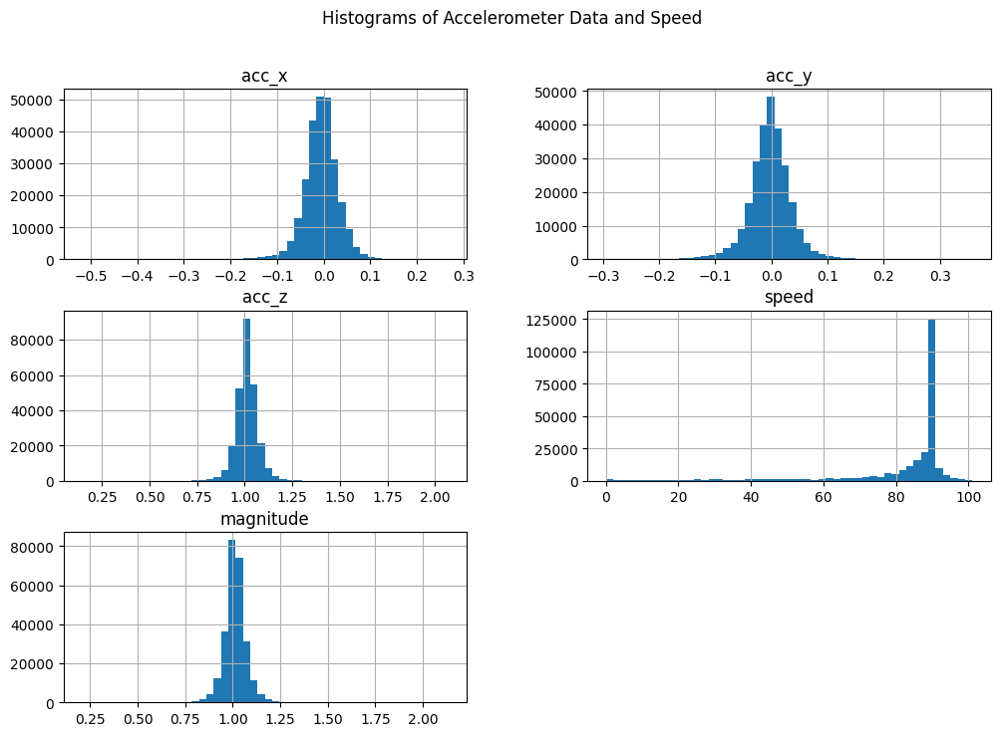

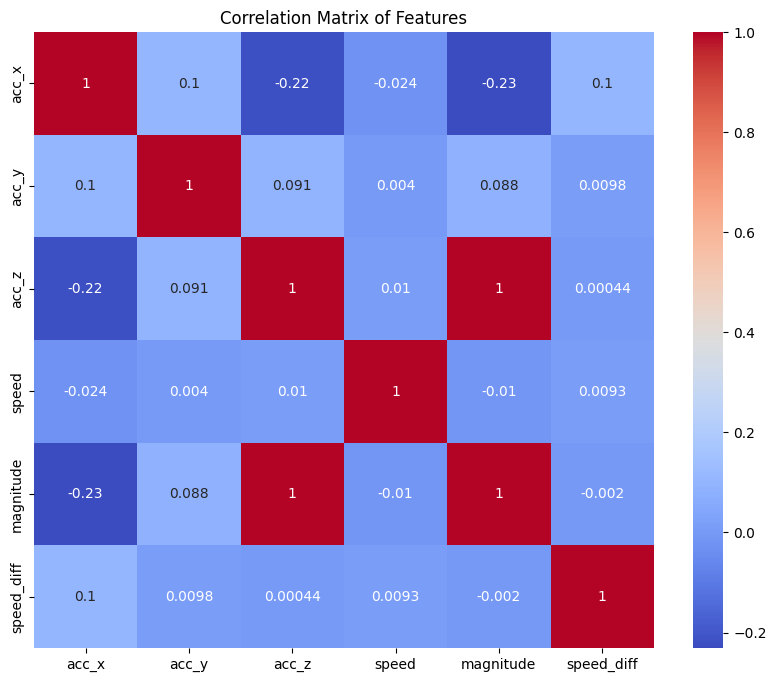

In [5]:
df[['acc_x', 'acc_y', 'acc_z', 'speed', 'magnitude']].hist(bins=50, figsize=(12, 8))
plt.suptitle("Histograms of Accelerometer Data and Speed")
plt.show()

plt.figure(figsize=(10, 8))
sns.heatmap(df[['acc_x', 'acc_y', 'acc_z', 'speed', 'magnitude', 'speed_diff']].corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Matrix of Features")
plt.show()


In [6]:
# Downsample the data to reduce the number of points
df_downsampled = df.iloc[::10, :].reset_index(drop=True)  # Take every 10th point

# Create a map with downsampled data
map_center = [df_downsampled['latitude'].mean(), df_downsampled['longitude'].mean()]
road_map = folium.Map(location=map_center, zoom_start=9)

for idx, row in df_downsampled.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=2, color='blue', fill=True, fill_opacity=0.6
    ).add_to(road_map)

road_map.save("road_conditions_map.html")
road_map



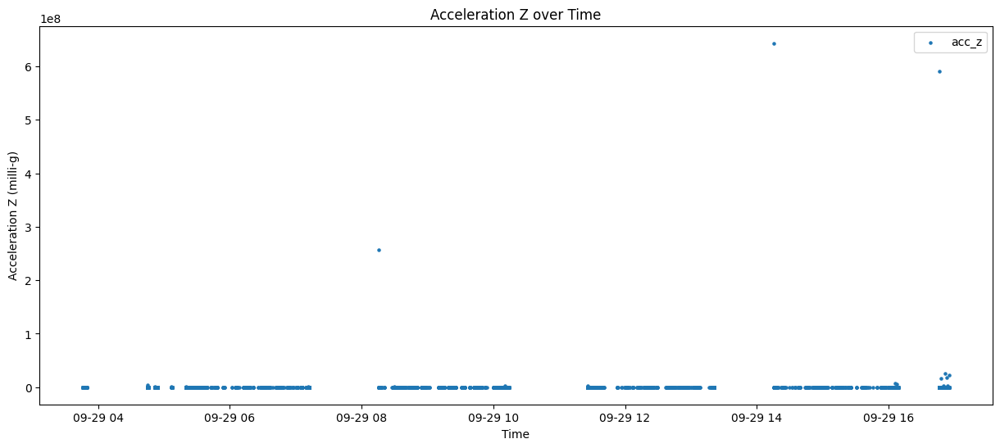

In [5]:
# Feature Engineering

types_of_road = df['road_type'].unique()
one_hot_dict = {road_type: idx for idx, road_type in enumerate(types_of_road)}

df['road_type'] = df['road_type'].map(one_hot_dict)




features = df[[ 'acc_z', 'speed' ]]

scaler = StandardScaler()
scaled_features = scaler.fit_transform(features.fillna(features.mean()))

iso_forest = IsolationForest(n_estimators=100, contamination=0.03, random_state=42)
df['anomaly'] = iso_forest.fit_predict(features)

anomalies = df[df['anomaly'] == -1]


plt.figure(figsize=(15, 6))
plt.scatter(anomalies['time'], anomalies['velocity_z'], label="acc_z", s=5)
plt.title("Acceleration Z over Time")
plt.xlabel("Time")
plt.ylabel("Acceleration Z (milli-g)")
plt.legend()
plt.show()

# print(anomalies[['time', 'latitude', 'longitude', 'speed', 'magnitude', 'road_type']])

anomalies.to_csv('../Data/anomalies.csv', index=False)

In [8]:

map_center = [df['latitude'].mean(), df['longitude'].mean()]
road_map = folium.Map(location=map_center, zoom_start=8)

for idx, row in anomalies.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Time: {row['time']}, Speed: {row['speed']}, Mag: {row['magnitude']}",
        icon=folium.Icon(color='red', icon='exclamation-sign')
    ).add_to(road_map)

# Display the map
road_map.save("anomalies_map.html")
road_map


In [9]:
features = anomalies[['acc_z', 'speed' ]]

scaler = StandardScaler()
scaled_features = scaler.fit_transform(features.fillna(features.mean()))

kmeans = KMeans(n_clusters=3, random_state=42)  
anomalies['cluster'] = kmeans.fit_predict(scaled_features)

cluster_to_class = {
    0: 'speed_bumps',
    1: 'cracks',
    2:'smaller vibrations/obstacles'
}

anomalies['class'] = anomalies['cluster'].map(cluster_to_class)


C:\Users\Vedant Shah\AppData\Local\Temp\ipykernel_22300\2668094901.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  anomalies['cluster'] = kmeans.fit_predict(scaled_features)
C:\Users\Vedant Shah\AppData\Local\Temp\ipykernel_22300\2668094901.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  anomalies['class'] = anomalies['cluster'].map(cluster_to_class)


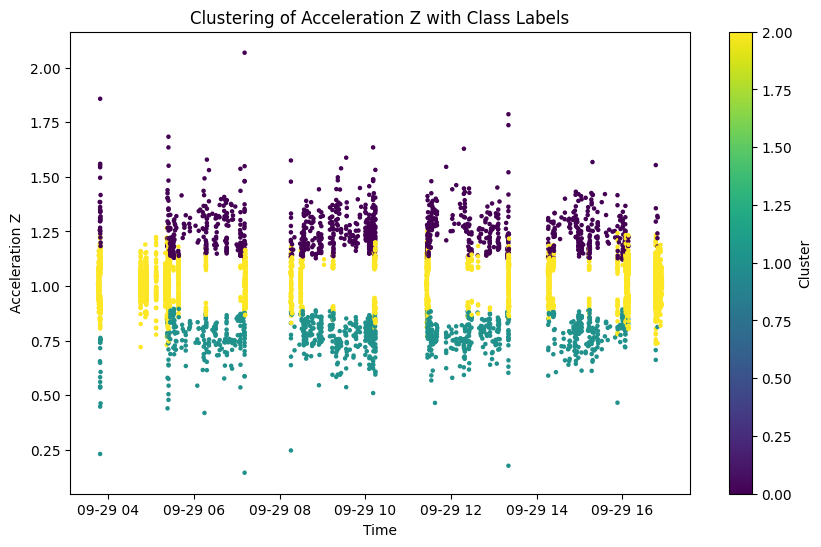


Sample of labeled anomalies:



,time,latitude,longitude,acc_z,class
226267,2022-09-29 16:05:25.352,43.239660,-2.873214,1.020,smaller vibrations/obstacles
228065,2022-09-29 16:47:00.358,43.234450,-2.871697,1.011,smaller vibrations/obstacles
216319,2022-09-29 13:20:04.620,42.358300,-3.651603,1.145,smaller vibrations/obstacles
127002,2022-09-29 07:11:49.388,42.357040,-3.656288,0.931,smaller vibrations/obstacles
201258,2022-09-29 11:25:51.348,43.357647,-4.076939,1.019,smaller vibrations/obstacles


In [10]:
plt.figure(figsize=(10, 6))
plt.scatter(anomalies['time'], anomalies['acc_z'], c=anomalies['cluster'], cmap='viridis',s=5)
plt.title('Clustering of Acceleration Z with Class Labels')
plt.xlabel('Time')
plt.ylabel('Acceleration Z')
plt.colorbar(label='Cluster')
plt.show()


print("\n\033[4mSample of labeled anomalies:\033[0m\n")
display(anomalies[['time', 'latitude', 'longitude', 'acc_z', 'class']].sample(n=5))


In [11]:
centroids = kmeans.cluster_centers_

distances = pairwise_distances(centroids)

print(f"\n\033[4mDistances between cluster centroids:\033[0m\n")
print(distances)

print(f"\n\033[4mClass distribution:\033[0m\n")
display(anomalies['class'].value_counts().to_frame())

sil_score = silhouette_score(scaled_features, anomalies['cluster'])

print(f'Silhouette Score: {sil_score}')



Distances between cluster centroids:

[[0.         3.23436219 2.5199771 ]
 [3.23436219 0.         2.60614503]
 [2.5199771  2.60614503 0.        ]]

Class distribution:



,count
class,
smaller vibrations/obstacles,5630
speed_bumps,1165
cracks,1079


Silhouette Score: 0.6747383058559002


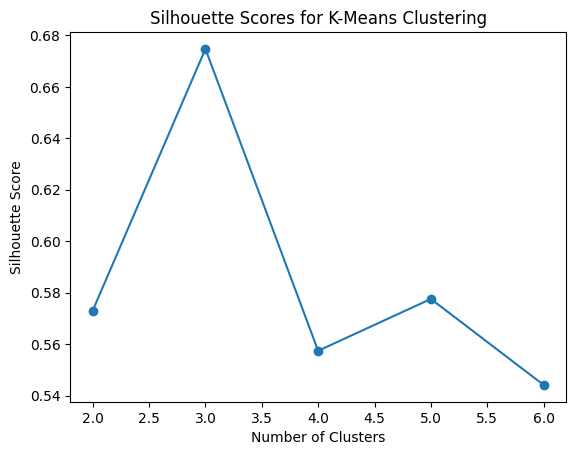

In [12]:
range_n_clusters = [2, 3, 4, 5, 6]
silhouette_scores = []

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(scaled_features)
    sil_score = silhouette_score(scaled_features, cluster_labels)
    silhouette_scores.append(sil_score)

# Plotting silhouette scores for different numbers of clusters
plt.plot(range_n_clusters, silhouette_scores, marker='o')
plt.title('Silhouette Scores for K-Means Clustering')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()